import the necessary libraries

In [1]:
import pandas as pd
import xgboost as xgb
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from xgboost.sklearn import XGBClassifier
import xgboost as xgb
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, accuracy_score, \
    classification_report
from collections import Counter
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import learning_curve
import itertools
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.model_selection import cross_val_score
import seaborn as sn
import xgboost as xgb
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GridSearchCV, ParameterGrid
import time
from sklearn.metrics import make_scorer, accuracy_score
from catboost import CatBoostClassifier, Pool
from tqdm import tqdm
import lightgbm as lgb
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, \
    ExtraTreesClassifier, VotingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.externals import joblib

/opt/conda/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


Read data from challenge (train and test dataset)

In [2]:
data_train = pd.read_csv('../input/defcon-dataset/train.csv')
data_test = pd.read_csv('../input/defcon-dataset/train.csv')
print (data_train.head(5))

   Allied_Nations  Diplomatic_Meetings_Set  Percent_Of_Forces_Mobilized  \
0              16                        1                         0.67   
1               8                        1                         0.11   
2               9                        1                         0.49   
3               7                        0                         0.30   
4               8                        1                         0.12   

   Hostile_Nations  Active_Threats  Inactive_Threats  Citizen_Fear_Index  \
0                3             6.0              25.0            0.787812   
1                2            38.0              48.0            0.419236   
2                3            32.0              69.0            0.582232   
3                2            31.0              52.0            0.589574   
4                5            13.0              42.0            0.552863   

   Closest_Threat_Distance  Aircraft_Carriers_Responding  Troops_Mobilized  \
0             

Check the number of labels on the train set.

In [3]:
print(data_train.DEFCON_Level.value_counts())

2    4270
3    3910
4    1212
1     498
5     110
Name: DEFCON_Level, dtype: int64


Concat train and test. Drop "ID" column and split train data

In [4]:
# concat train and test
data = pd.concat([data_train, data_test], axis=0)
# drop 'id' column
data = data.drop(columns=['ID'])
# Retrieve data from the train set
X = data[:10000].drop(columns=['DEFCON_Level'])
# Retrieve label from train set
y = data[:10000].DEFCON_Level
# Retrieve data from test set
X_test = data[10000:].drop(columns=['DEFCON_Level'])
# split train file into train set (0.75) and valid set (0.25). The valid set is used to evaluate the model on the train set
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.25, random_state=42)

Visualize data to identify important features

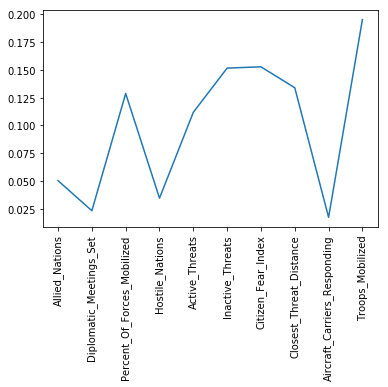

In [5]:
def feature_importances():
    for c in data.columns[data.dtypes == 'object']:
        X_train[c] = X_train[c].factorize()[0]
    rf = RandomForestClassifier()
    rf.fit(X_train, y_train)
    plt.plot(rf.feature_importances_)
    plt.xticks(np.arange(X_train.shape[1]), X_train.columns.tolist(), rotation=90)
    plt.show()
    
feature_importances()

Visualize correlation matrix, this stage is very important. A correlation matrix is a table showing correlation coefficients between variables. Each cell in the table shows the correlation between two variables. A correlation matrix is used to summarize data, as an input into a more advanced analysis, and as a diagnostic for advanced analyses.

In [6]:
corr = X.corr()
corr.style.background_gradient(cmap='coolwarm')

,Allied_Nations,Diplomatic_Meetings_Set,Percent_Of_Forces_Mobilized,Hostile_Nations,Active_Threats,Inactive_Threats,Citizen_Fear_Index,Closest_Threat_Distance,Aircraft_Carriers_Responding,Troops_Mobilized
Allied_Nations,1,-0.278779,0.650308,0.111896,-0.113609,-0.0674959,0.647604,-0.668521,0.0963517,-0.110071
Diplomatic_Meetings_Set,-0.278779,1,-0.576116,-0.0366618,0.0190459,0.0890068,-0.0307563,0.241155,-0.106499,-0.201561
Percent_Of_Forces_Mobilized,0.650308,-0.576116,1,0.149317,-0.0366748,0.0544737,0.357324,-0.529314,0.166989,0.0858701
Hostile_Nations,0.111896,-0.0366618,0.149317,1,0.146773,0.220252,0.299244,-0.081724,-0.00486514,0.0251033
Active_Threats,-0.113609,0.0190459,-0.0366748,0.146773,1,0.67497,-0.00950969,0.0347004,-0.0233168,-0.0841882
Inactive_Threats,-0.0674959,0.0890068,0.0544737,0.220252,0.67497,1,0.103296,-0.0846696,-0.0041985,-0.227941
Citizen_Fear_Index,0.647604,-0.0307563,0.357324,0.299244,-0.00950969,0.103296,1,-0.336929,0.0855404,-0.495305
Closest_Threat_Distance,-0.668521,0.241155,-0.529314,-0.081724,0.0347004,-0.0846696,-0.336929,1,-0.00863589,0.177008
Aircraft_Carriers_Responding,0.0963517,-0.106499,0.166989,-0.00486514,-0.0233168,-0.0041985,0.0855404,-0.00863589,1,0.0738186
Troops_Mobilized,-0.110071,-0.201561,0.0858701,0.0251033,-0.0841882,-0.227941,-0.495305,0.177008,0.0738186,1


We will preprocess two important fields in the data: Closest_Threat_Distance, Troops_Mobilized

In [7]:
def feature_extract():
    X.Closest_Threat_Distance = X.Closest_Threat_Distance / 1.06
    X.Troops_Mobilized = X.Troops_Mobilized / 100
    values = X.Troops_Mobilized.values.tolist()
    for idx in range(len(values)):
        if ".3" in str(values[idx]):
            values[idx] = round(values[idx] * 3) / 44
        elif ".6" in str(values[idx]):
            values[idx] = round(values[idx] * 3 / 2) / 44
    X.Troops_Mobilized = values
    X.Percent_Of_Forces_Mobilized = X.Percent_Of_Forces_Mobilized / 0.01
    X.Closest_Threat_Distance = X.Closest_Threat_Distance / 1.06
feature_extract()

Compare tree based models to select good model models for this data set.
The models I use below are : SVC, DecisionTreeClassifier, AdaBoostClassifier, RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, MLPClassifier, KNeighborsClassifier, LogisticRegression, LinearDiscriminantAnalysis

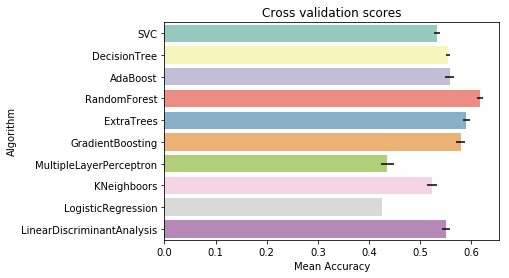

In [8]:
def compare_tree_based_models():
    random_state = 2
    classifiers = [SVC(random_state=random_state), DecisionTreeClassifier(random_state=random_state),
                   AdaBoostClassifier(DecisionTreeClassifier(random_state=random_state), random_state=random_state,
                                      learning_rate=0.1), RandomForestClassifier(random_state=random_state),
                   ExtraTreesClassifier(random_state=random_state),
                   GradientBoostingClassifier(random_state=random_state), MLPClassifier(random_state=random_state),
                   KNeighborsClassifier(), LogisticRegression(random_state=random_state), LinearDiscriminantAnalysis()]

    cv_results = []
    for classifier in classifiers:
        cv_results.append(cross_val_score(classifier, X_train, y=y_train, scoring="accuracy", cv=4, n_jobs=4))

    cv_means = []
    cv_std = []
    for cv_result in cv_results:
        cv_means.append(cv_result.mean())
        cv_std.append(cv_result.std())

    cv_res = pd.DataFrame(
        {"CrossValMeans": cv_means, "CrossValerrors": cv_std, "Algorithm": ["SVC", "DecisionTree", "AdaBoost",
                                                                            "RandomForest", "ExtraTrees",
                                                                            "GradientBoosting",
                                                                            "MultipleLayerPerceptron", "KNeighboors",
                                                                            "LogisticRegression",
                                                                            "LinearDiscriminantAnalysis"]})

    g = sns.barplot("CrossValMeans", "Algorithm", data=cv_res, palette="Set3", orient="h", **{'xerr': cv_std})
    g.set_xlabel("Mean Accuracy")
    g = g.set_title("Cross validation scores")
    plt.show()

compare_tree_based_models()

I will use the decision tree, which model I am most confident in, I will use a combination of Kfold, GridSearchCV and BaggingClassifier to choose the best parameters for this data.

In [9]:
scaler_minmax = MinMaxScaler()
scaler_standard = StandardScaler()
# params for decision tree classifier
dt_param = {"base_estimator__criterion": ["gini", "entropy"],
            "base_estimator__max_depth": list(range(2, 32, 1)),
            'base_estimator__random_state': [21],
            'base_estimator__max_features': [10],
            "base_estimator__min_samples_leaf": list(range(5, 20, 5)),
            'base_estimator__min_samples_split': list(range(5, 20, 5)),
            'base_estimator__min_impurity_decrease': [0.00005, 0.0001, 0.0002, 0.0005, 0.001, 0.002, 0.005, 0.01,
                                                      0.05, 0.1]}
max_score = 0
# use Kfold
sss = StratifiedKFold(n_splits=4, random_state=None, shuffle=False)
for train_index, val_index in sss.split(X, y):
    start_time = time.time()
    print("Train:", train_index, "Val:", val_index)
    X_train, X_valid = X.iloc[train_index], X.iloc[val_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[val_index]
    # standardized data
    X_train = scaler_standard.fit_transform(X_train)
    X_valid = scaler_standard.fit_transform(X_valid)
    # Use BaggingClassifier 
    model = BaggingClassifier(base_estimator=DecisionTreeClassifier(), oob_score=True, random_state=42)
    # Use GridSearchCV
    model = GridSearchCV(estimator=model, param_grid=dt_param, cv=4, verbose=3)
    model.fit(X_train, y_train)
    print(model.best_score_, model.best_params_)
    # # tree best estimator
    model = model.best_estimator_
    # Save the best params after training
    joblib.dump(model, 'DecisionTreeClassifier.pkl')
    # Evaluate the model with a valid set
    tree_score = cross_val_score(model, X_valid, y_valid, cv=4)
    print('Classifier Cross Validation Score', round(tree_score.mean() * 100, 2).astype(str) + '%')
    print("time execution :", time.time() - start_time)


Train: [2330 2344 2347 ... 9997 9998 9999] Val: [   0    1    2 ... 2866 2920 2953]
Fitting 4 folds for each of 5400 candidates, totalling 21600 fits
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.580, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.580, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.580, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.592, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.592, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.592, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.564, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.591, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.591, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.585, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=5, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.585, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.584, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.584, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.584, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.577, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=6, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=7, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=8, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=18, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=19, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.4s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.583, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=15, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=21, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.654, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.586, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.549, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.549, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.555, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=25, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.598, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.536, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.538, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.572, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.550, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.572, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.660, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.660, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.662, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.662, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=24, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.531, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.660, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.660, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.662, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.662, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.654, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.654, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.654, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.604, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.557, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=30, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__m

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=9, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=12, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.602, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.603, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.601, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.569, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.556, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.552, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.541, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.540, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_le

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_le

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=20, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.656, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.651, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.653, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.652, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.661, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.640, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.655, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_le

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.580, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.566, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.565, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.565, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.566, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.519, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.543, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=26, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.545, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.647, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.657, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.650, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=27, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.554, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_sa

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__m

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=3, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.563, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.573, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.558, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.562, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.574, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.551, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=4, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.597, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.592, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.592, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.592, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=13, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.596, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.600, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=14, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.603, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.591, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.602, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.592, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.592, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.592, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.588, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.598, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.595, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.599, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.612, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.2s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.581, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.576, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.579, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.582, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.578, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.547, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_esti

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.537, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.542, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_es

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.544, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__mi

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimato

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimat

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.427, total=   0.1s
[CV] base_estimator__criterion=gini, base_estimator__max_depth=31, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estima

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.534, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.546, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estim

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=2, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_est

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.606, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.606, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.618, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.611, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.605, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.605, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.633, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.605, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=10, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.632, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.623, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=11, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.612, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=16, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.626, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=17, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.630, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.629, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.616, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.644, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_le

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=1

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, b

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=22, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=23, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.607, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.619, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.631, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.631, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.594, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_lea

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.589, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.587, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.590, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.593, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_l

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.560, total=   0.2s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.560, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.567, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.559, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.01, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.570, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=5,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.05, base_estimator__min_samples_leaf

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_e

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=5, bas

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=10,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, ba

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.520, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, 

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.533, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means to

[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.539, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 
[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.535, total=   0.1s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=28, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.1, base_estimator__min_samples_leaf=15,

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.622, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=5e-05, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.640, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.625, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.640, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.625, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.4s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.645, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.621, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.635, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0001, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.608, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.643, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.628, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.615, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.637, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.620, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.638, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0002, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.609, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.611, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.622, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.611, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.642, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.624, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.617, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.648, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.649, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.636, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=10, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.614, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=10, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.646, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.634, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.0005, base_estimator__min_samples_leaf=15, base_estimator__min_samples_split=15, base_estimator__random_state=21, score=0.610, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.641, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.639, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.627, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


[CV]  base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=5, base_estimator__random_state=21, score=0.613, total=   0.3s
[CV] base_estimator__criterion=entropy, base_estimator__max_depth=29, base_estimator__max_features=10, base_estimator__min_impurity_decrease=0.001, base_estimator__min_samples_leaf=5, base_estimator__min_samples_split=10, base_estimator__random_state=21 


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:633: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/_bagging.py:638: RuntimeWarning: invalid value encountered in true_divide
  predictions.sum(axis=1)[:, np.newaxis])


After the training, we have found the best params just reload the model and create the sample_submission.csv.

In [10]:
def write_submission(md):
    sample_submission = pd.DataFrame()
    sample_submission['ID'] = data_test.ID
    sample_submission['DEFCON_Level'] = md.predict(StandardScaler().fit_transform(X_test))
    sample_submission.to_csv('sample_submission.csv', index=False)
    print('write sample_submission completed')
    
# Load model with best params
model = joblib.load('DecisionTreeClassifier.pkl')
write_submission(model)

write sample_submission completed


![LeaderBoard](http://https://imgur.com/a/M9lbxIJ)
For now, just using the best Decision and params, I'm standing # 5, you can stuff other algorithms, the contest is still going till March 20.